#### **Agenda:**
In this Lecture, we'll explore a range of topics related to image processing and segmentation. :
   -  We'll discuss how to enhance the portrait effect of Google Pixel phone, a useful technique for taking stunning portrait photographs.
   - We'll delve into the world of image segmentation, exploring both semantic and instance segmentation techniques and the differences between them.
   - We'll also dive into how we evaluate image segmentation models, highlighting the importance of the Dice coefficient. 
   - We'll introduce the powerful Unet algorithm, a popular tool for image segmentation tasks.
   - We'll wrap up by exploring the intuitive workings of the Mask RCNN algorithm, a state-of-the-art method for object detection and segmentation.


Whether you're a budding photographer or an expert in computer vision, this lecture is sure to provide valuable insights and knowledge.

- Dataset :  https://drive.google.com/drive/folders/1NKEogbBaPsKUw_6qEkcB_nCB4P84Alwl?usp=sharing


### Outline

- Motivation 
- Business Case
- EDA
- image segmentation  over classification / detection
-  Semantic vs Instance Segmentation
- The idea of Encoder-Decoder network
- Dice loss, Dice coeff
- FCN coding tutorial
- Unet coding tutorial
- Intuition for Mask R-CNN
- Intuition for DeeplabV3

### Motivation

- We started with image classification, which is very coarse and high level : whether an object is present in the image or not
- Then in Object Detection we learnt about object localization : where exactly the object is present in the image and  we drew a rectangular bounding box around it
- But sometimes bounding boxes are not enough, we need more precision,  extract boundary of the object
- For Example Tumor tissue dectection, tissue in the red have quite complex structure and we cannot draw bounding boxes around them
- Today we are going to learn about image segmentation, where we do pixel level analysis of the object 
- We will learn to form very complex boundary when required 



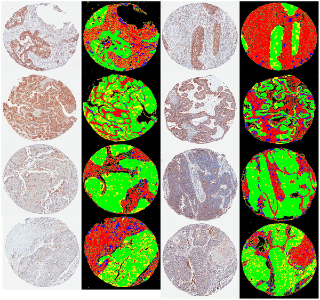

### Problem statement

- You are a machine learning researcher at google, working in pixel mobile team
- You are enhancing the portrait effect of google pixel phone with using single camera and no extra optical hardware
- Your task is to build an algorithm that separates out body/ background from selfies, we want to blur out the background

### What is image segmentation? (Semantic vs Instance Segmentation)


-   Lets understand with an example : 

- **Image Classification** Identify the contents of the image : person, tree, grass, sky

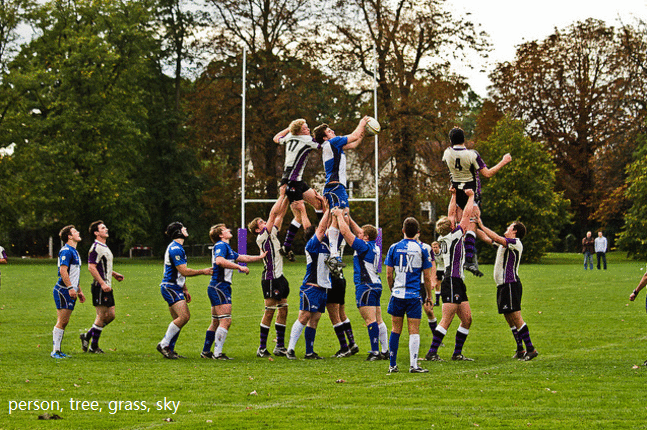

- **Object detection** : Identify the content and its position in the image

- 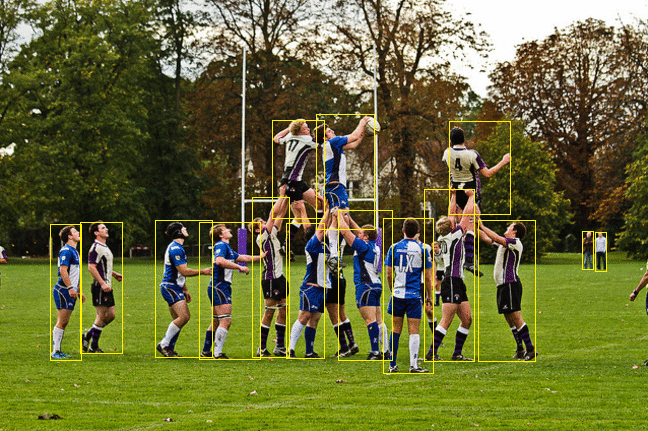

- **Semantic Segmentation** : Each pixel is labeled in the image in categories. As shown in the following figure, the image is divided into human (red), tree (dark green), grass (light green), sky (blue).

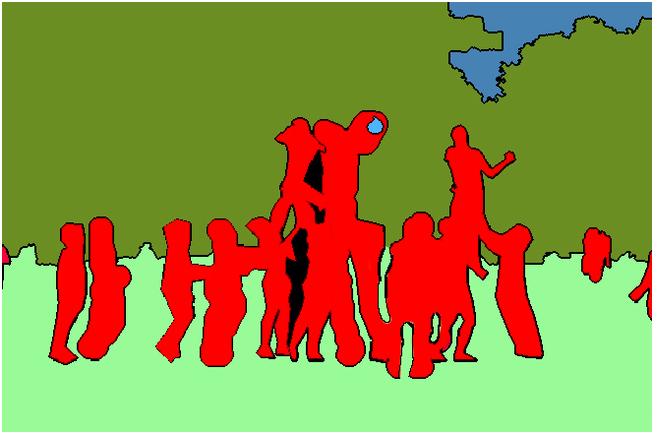

- **Instance Segmentation**
- The combination annotation of target detection and semantic segmentation.
- The target detection comes first, and then each pixel is labeled (semantic segmentation).
- Compared to the image above, we take the person as the target objection for example:
 - Semantic segmentation does not distinguish different instances in the same category (all people are marked red).
 - Instance segmentation distinguishes different instances of the same category. (different people are distinguished by different colors)

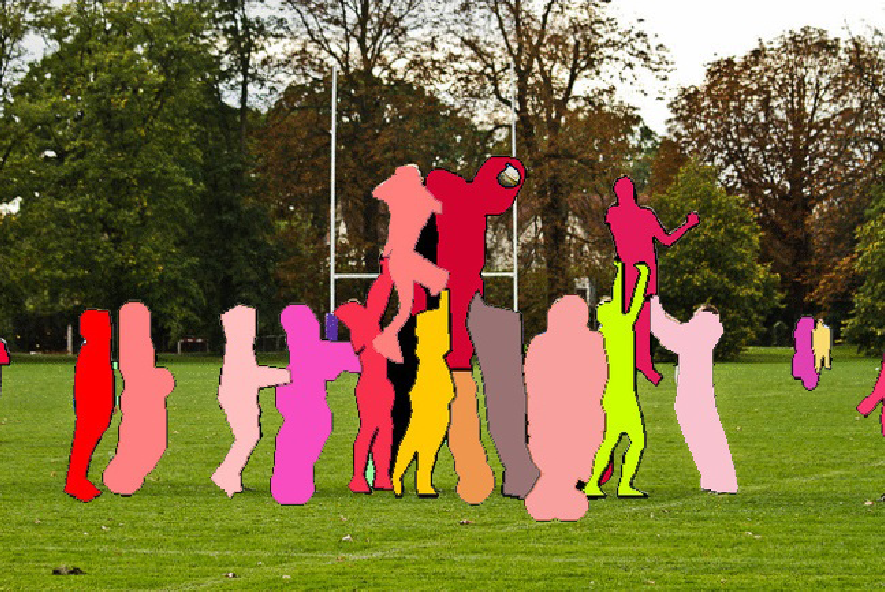

- Then we label the background 
- Here in our business case we are only interested in single person detection, we dont need to worry about instance segmentation,but principles are same for it

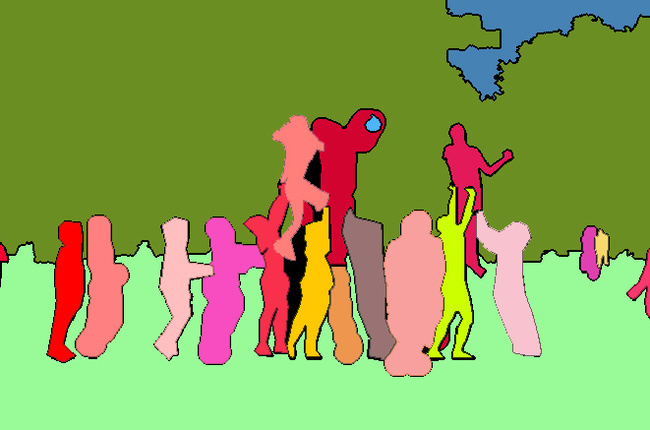

### The Training Dataset


In [2]:
import os 
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf

- Now lets look at the dataset of our business case

In [6]:
from google.colab import drive
drive.mount('/content/gdrive/',force_remount=True)
path ='/content/gdrive/My Drive/'

Mounted at /content/gdrive/


In [7]:
images = np.load(path+'data/img_uint8.npy')
mask =  np.load(path+'data/msk_uint8.npy')

print(f'Training X data: {images.shape}, Ground Truth: {mask.shape}')
print(f'max pixel value: {mask.max()} , min pixel value: {mask.min()}')

Training X data: (18698, 128, 128, 3), Ground Truth: (18698, 128, 128, 1)
max pixel value: 255 , min pixel value: 0


need to change mask from pixel to classwise 
- so changing 255 to 1
- where 1 denotes Person mask
- and 0 denotes background

In [ ]:
mask[mask>0] = 1
Y_t = tf.keras.utils.to_categorical(mask)
Y_t.shape

(18698, 128, 128, 2)

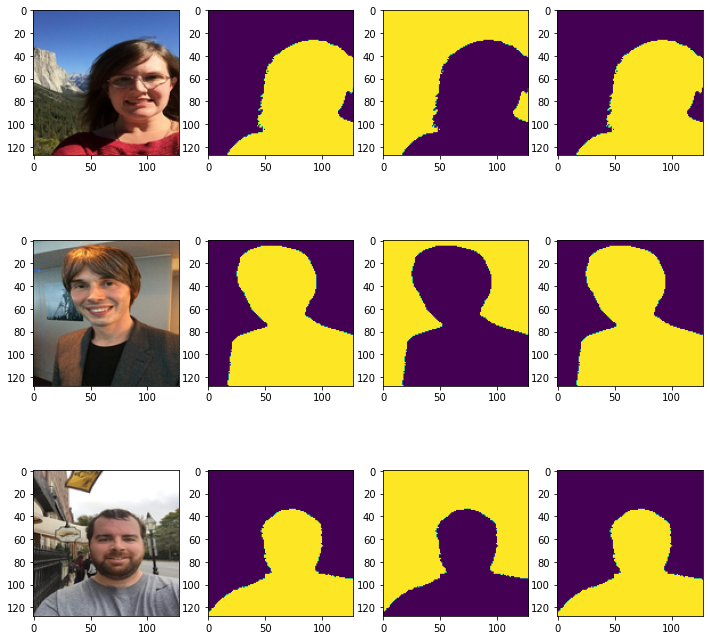

In [ ]:

fig,ax = plt.subplots(3,4,figsize=(12,12))

for idx1 in range(0,3):
    ax[idx1][0].imshow(images[idx1])
    ax[idx1][1].imshow(mask[idx1,:,:,0])
    ax[idx1][2].imshow(Y_t[idx1,:,:,0])
    ax[idx1][3].imshow(Y_t[idx1,:,:,1])

plt.show()

### Why do we need image segmentation over classification / detection? 


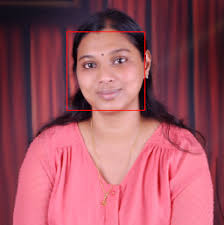

- what if we try to segment using drawing bounding boxes?
- We will able blur out outer section of the bounding box but Bounding box is not the extract representation of our person in a selfie
- We wont be able to blur out areas that are just outside our face boundary
- Instead we can go through every pixel of the image and classify if it is background or not

### How should we design the architecture ?

- Here we are predicting labels for each pixel, therefore we need to use a CNN  layer with same HxW of the input img shape
- Each class will require one channel, therefore output layer will have dim (bs, H, W, #oflabels)

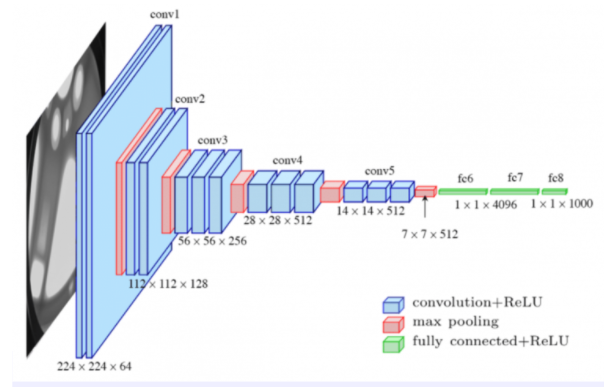

- Til now we have seen models where HxW dim decreases as we go down the model and number of features increases
- For ex here, HxW ->224 -> 112 -> 56 -> 28 -> 14 ->7 and #offeatures 3 -> 64 -> 128 ->256 ->512
- But we would require  224x224 instead of 7x7 / 1 instead of 512 for our final layer


- Final CNN layers conveys Deep, coarse, semantic information: which Answers the “What”
- First few layers conveys Shallow, fine, appearance information: which Answers the “Where”
- In image segmentation we need both "What" and "Where", "What" helps in detecting the label(face/background)
- "Where" helps in dectecting the boundary of the "What", in image classification models we lack the "Where" information
- Therfore we skip connect  initial layers with final layer (to infuse "Where") 

 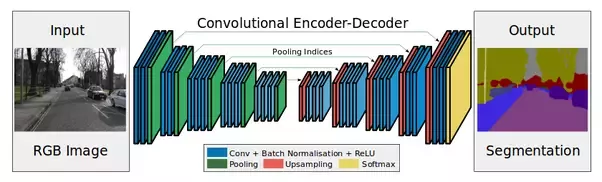

- But How would we increase HxW 7x7 to 224x224?
- [Q] What if we dont use decrease it? Ans : We will lack the "What"
- We use something called Encoder Decoder network 
- Encoder part is same as designed for object classification without Flatten/FC layers 
- Each encoder layer has a corresponding decoder layers
- Decoder network up-samples its input feature map using transposed Convolutional Layer

-  transposed Convolutional Layer  also  known as the Deconvolutional layer. 
- if the output generated through a standard convolutional layer is deconvolved,then you get back the original input.
- Transposed convolution doesn’t reverse the standard convolution by values, rather by dimensions only.

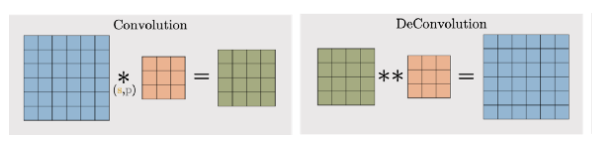

- **Transpose Convolution With Stride 2, No Padding**
- we use a 2 by 2 kernel again, set to stride 2, applied to a 3 by 3 input.
- The process for transposed convolution has a few extra steps but is not complicated.
- First we create an intermediate grid which has the original input’s cells spaced apart with a step size set to the stride. 
-  we can see the pink cells spaced apart with a step size of 2. The new in-between cells have value 0
- Next we extend the edges of the intermediate image with additional cells with value 0. 
- We add the maximum amount of these so that a kernel in the top left covers one of the original cells
- Finally, the kernel is moved across this intermediate grid in step sizes of 1. This step size is always 1.
- The stride option is used to set how far apart the original cells are in the intermediate grid.
- Unlike normal convolution, here the stride is not used to decide how the kernel moves.
- If we used normal conv layer, convloving over a 6x6 input image with 2x2 kernal with stride=2, no padding
- we would get 3x3 final output (here its opposite)
- Animations: https://github.com/vdumoulin/conv_arithmetic

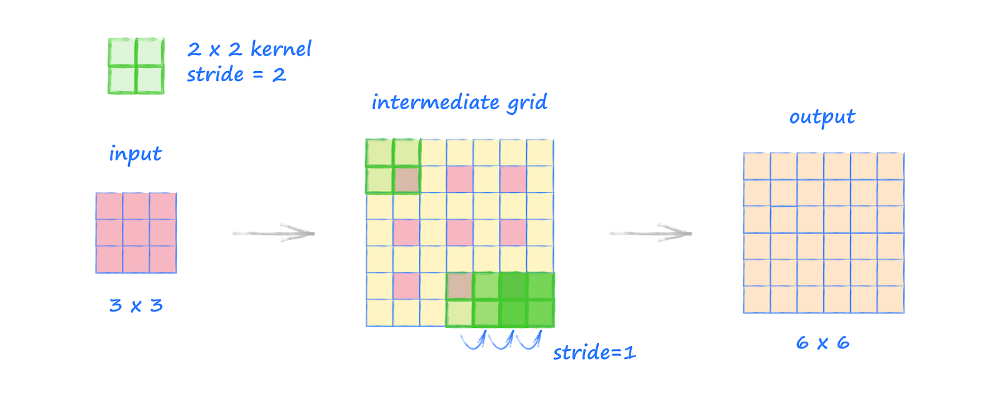

- **Transpose Convolution With Stride 1, No Padding**
- In the previous example we used a stride of 2 because it is easier to see how it is used in the process. In this example we use a stride of 1.
- The process is exactly the same. Because the stride is 1, the original cells are spaced apart without a gap in the intermediate grid. 

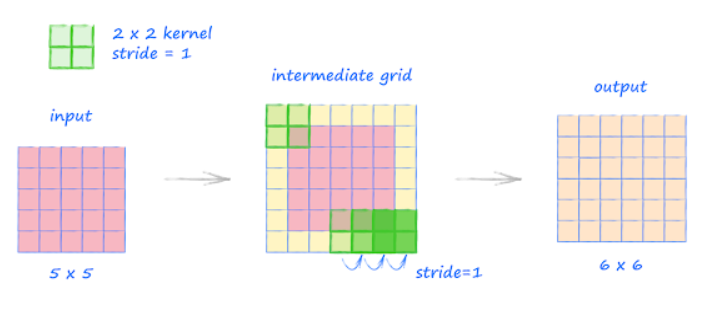

- **Padding in transposed conv layers**
-  Unlike the normal convolution where padding is used to expand the image, here it is used to reduce it.
- The padding is set to 1, so we remove 1 ring from around the grid. This leaves the grid at size 5 by 5. 
- Applying the kernel to this grid gives us an output of size 4 by 4.



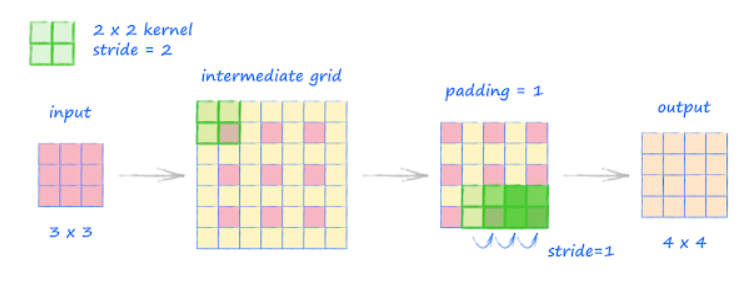

- The Tensorflow function for this transpose convolution is: `tf.keras.layers.Conv2DTranspose()`

-  the formula for transposed convolution is:

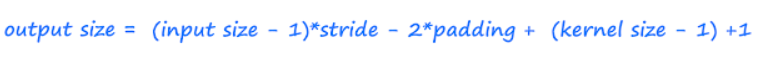

- Comparing with normal conv formula 
- we are multiplying `strides`, instead of divding 
- we are subtracting `2*padding` instead of adding 
- we are adding `(kernel_size -1)` tern  instead of subtracting 
- +1 instead of -1

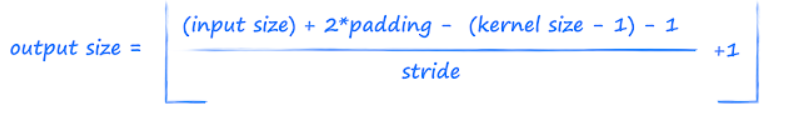

### How we will evaluate Image Segmentation Models?

- We classify pixels of an image as 1 or 0. If there is a mask in a pixel we state 1, if there is not a mask (background) we state 0.
-  Making pixelwise binary classification of image

-  we can formulate it a two-class semantic segmentation problem, with binary cross entropy loss as the loss function. 
- . However, it works badly because of two reasons: 
 - highly unbalanced label distribution and
 -  per-pixel intrinsic issue of cross entropy loss.
- When using cross entropy loss, the statistical distributions of labels play a big role in training accuracy. 
- The more unbalanced the label distributions are, the more difficult the training will be.
- the loss is calculated as the average of per-pixel loss,  without knowing whether its adjacent pixels are boundaries or not. 
-  As a result, cross entropy loss only considers loss in a micro sense rather than considering it globally, which is not enough for image level prediction.

- So we need a new loss that can handle class imblance and consider a macro sense of prediction distribution 

- **IOU**
- We have discussed IOU in object detecion 

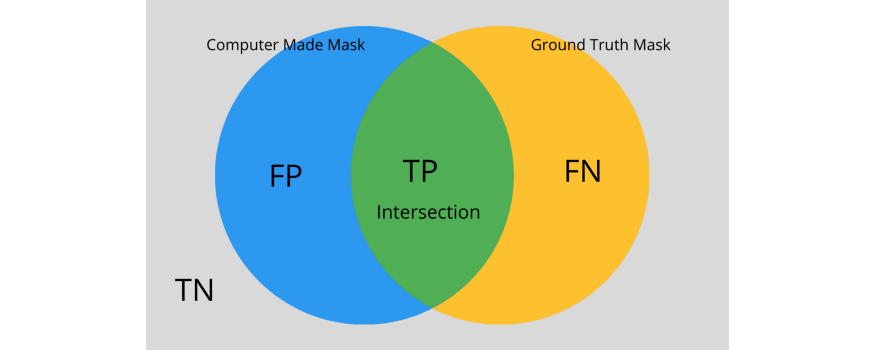

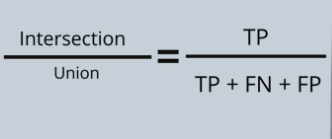

- IOU can be used in image segmentation, but we use a slightly different metric **Dice**
- Dice coefficient is very similar to IOU. Dice coefficient double counts the intersection(TP).

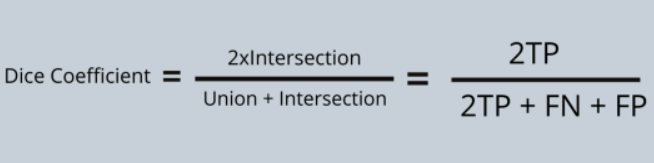

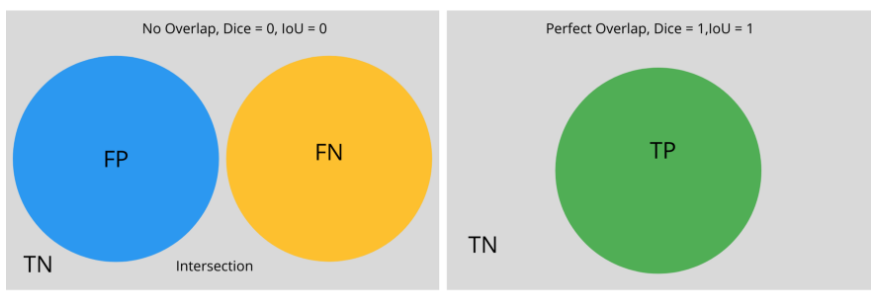

- In general, the IoU metric tends to penalize single instances of bad classification more than the Dice score quantitatively even when they can both agree that this one instance is bad.
- Similarly to how L2 can penalize the largest mistakes more than L1, the IoU metric tends to have a "squaring" effect on the errors relative to the Dice score.
- So the Dice score tends to measure something closer to average performance, while the IoU score measures something closer to the worst case performance.
- Dice score has more weightage of TP in the bottom

### FCN Coding Tutorial  
- With This, we will dive deeper into the Convolutional Encoder-Decoder models by implementing a Fully Convolutional Neural Networks from scratch  


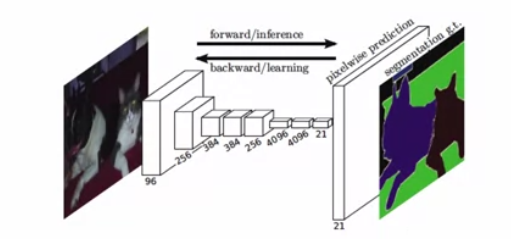

### How does the model understand the key features of the image ?
- The FCN model uses convolutional layers as feature extractor
- When used in the Encoder part of the FCN model by downsampling the image 

Now, the last layers contains all the key features we pass it to a decoder part of the model instead of Fully Connected Layers
- The decoder consists of Deconvolutional layers that upsamples these key features to the original size of the image
### Why do we need the original size of the image ? 
- to get a pixelwise labelling of the image so as to get "where" exactly object is in our image

### But how to create an Encoder part of a FCN model ?
- By using a popular pretrained CNN model like VGG-16, Resnet-50 but without their Fully Connected layers
- These Pretrained models helps in quick and accurate feature extraction

#### Lets see how does the decoder part of the FCN model work
- For this, we take an example of FCN-32 architecture 


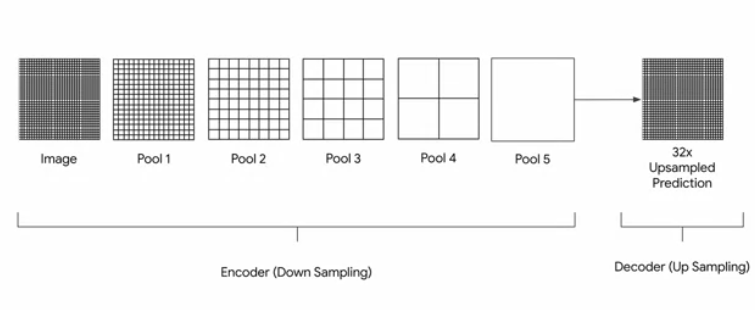

- Notice a Pooling layer with kernel = 2 and stride =2 ,always reduces the image dimension by a factor of 2 
#### What will be the output of Pool5 ?
- Image size reduced by a factor of 2^5 = 32
- hence to upsample the features back to the original size of the image, a 32x Upsampling using transposed Convolution layer is done
- 32x Upsampling is performed using a stride size =  32

#### What can we notice?
- With such a 32x upsample, it will lead to high information loss which decreases the accuracy of the model 

- Lets take another example of FCN-8 architecture 

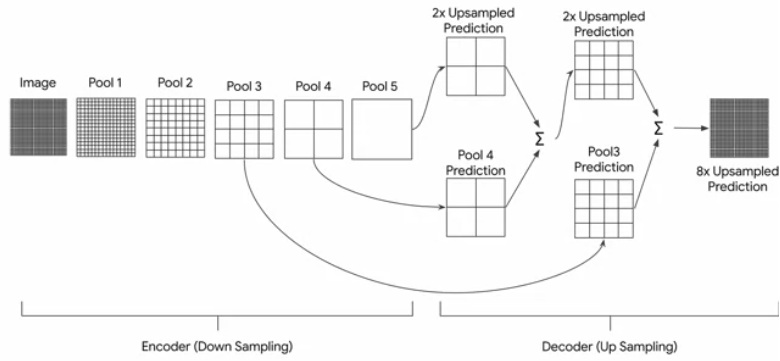

- Notice, how now there are two 2x Upsampled layers before a final 8x Upsample making it less inclined to information loss.
- Also output of Pool4 and Pool3 layers from the Encoder part are added with  the decoder output layers.
### Why were these layers added to the decoder part?
- to further retain any information loss caused due to upsampling. 

This connection of output layers from the Encoder part to the Decoder part of the model is what skip connections are that further help the Model to have accurate result.

### Fusing output/Skip connection is important
- deep features can be obtained when going deeper, spatial location information is also lost when going deeper. That means output from shallower layers have more location information. If we combine both, we can enhance the result.
- Deep, coarse, semantic information: Answers the “What”
- Shallow, fine, appearance information: Answers the “Where”




- Now, we will be implementing a FCN-8 from scratch using VGG-16 as encoder on our dataset   


In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(images,Y_t, test_size=0.33, random_state=42)

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard
import tensorflow as tf
import datetime

# Clear any logs from previous runs
!rm -rf ./logs/ 

In [ ]:
def FCN8():
    VGG16 = tf.keras.applications.VGG16(weights="imagenet", include_top=False,input_tensor=tf.keras.Input(shape=(128, 128, 3)))
    VGG16.trainable  = False
    x = VGG16(VGG16.input)

    #Decoder
    o = tf.keras.layers.Conv2D( 4096 , ( 7 , 7 ) , activation='relu' , padding='same', name="conv6")(x)
    conv7 = tf.keras.layers.Conv2D( 4096 , ( 1 , 1 ) , activation='relu' , padding='same', name="conv7")(o)
    print(o.shape,conv7.shape)
    ## 4 times upsamping for pool4 layer
    conv7_4 = tf.keras.layers.Conv2DTranspose( 2 , kernel_size=(4,4) ,  strides=(4,4) , use_bias=False)(conv7)
    
    ## 2 times upsampling for pool411
    
    pool4 = VGG16.get_layer('block4_pool').output
    pool411 = tf.keras.layers.Conv2D( 2 , ( 1 , 1 ) , activation='relu' , padding='same', name="pool4_11")(pool4)
    pool411_2 = tf.keras.layers.Conv2DTranspose(2 , kernel_size=(2,2) ,  strides=(2,2) , use_bias=False)(pool411)
    
    pool3 = VGG16.get_layer('block3_pool').output
    pool311 = tf.keras.layers.Conv2D(2 , ( 1 , 1 ) , activation='relu' , padding='same', name="pool3_11")(pool3)
    o = tf.keras.layers.Add(name="add")([pool411_2, pool311])
    
    print(o.shape,conv7_4.shape)
    o = tf.keras.layers.Add(name="add1")([o, conv7_4 ])
    o = tf.keras.layers.Conv2DTranspose(2 , kernel_size=(8,8) ,  strides=(8,8) , use_bias=False)(o)
    o = tf.keras.layers.Activation('softmax')(o)
    
    model = tf.keras.Model(VGG16.input, o)

    return model



In [ ]:
fcn = FCN8()

fcn.summary()

58900480/58889256 [==============================] - 0s 0us/step
(None, 4, 4, 4096) (None, 4, 4, 4096)
(None, 16, 16, 2) (None, 16, 16, 2)
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 128, 128, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 128, 128, 64  3

In [ ]:
def dice_coefficient(y_true, y_pred, smooth=1):
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.keras.backend.sum(y_true_f * y_pred_f)
    return  (2. * intersection + smooth) / (tf.keras.backend.sum(y_true_f) + tf.keras.backend.sum(y_pred_f) + smooth)

In [ ]:
fcn.compile(loss= 'categorical_crossentropy', optimizer="adam", metrics=["accuracy",dice_coefficient])

In [ ]:
#For tensorboard to store the performance metrics

# !rm -rf ./logs/ 

# log_dir = path+"/data/logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
# tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

In [ ]:
# trains the FCN-8 model

# hist = fcn.fit(X_train,y_train,batch_size = 32,epochs = 20,validation_data=(X_test, y_test),callbacks=[tensorboard_callback] )

In [ ]:
%tensorboard --logdir /content/gdrive/MyDrive/Segmentation/data/logs/fit

Reusing TensorBoard on port 6006 (pid 314), started 0:28:08 ago. (Use '!kill 314' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
fcn = tf.keras.models.load_model(path+'fcn.h5', custom_objects={'dice_coefficient':dice_coefficient})

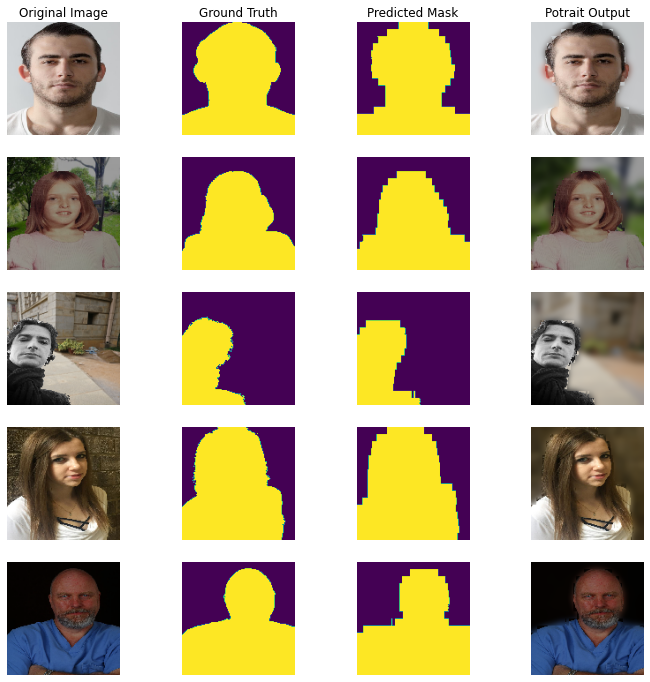

In [ ]:
preds = fcn.predict(X_test[:5])
preds = np.argmax(preds,axis=-1)
y_true = np.argmax(y_test[:5],axis=-1)

fig,ax = plt.subplots(5,4,figsize=(12,12))

for idx1 in range(0,5):
    if idx1==0:
            ax[idx1][0].set_title('Original Image')
            ax[idx1][1].set_title('Ground Truth')
            ax[idx1][2].set_title('Predicted Mask')
            ax[idx1][3].set_title('Potrait Output')

    ax[idx1][0].imshow(X_test[idx1])
    ax[idx1][1].imshow(y_true[idx1])
    ax[idx1][2].imshow(preds[idx1])
    
    blurred_img = cv2.GaussianBlur(X_test[idx1].copy(), (21, 21), 0)
    out = np.where(preds[idx1][:,:,None]==np.array([1]), X_test[idx1].copy(), blurred_img)
    
    ax[idx1][3].imshow(out)

    ax[idx1][0].axis('off')
    ax[idx1][1].axis('off')
    ax[idx1][2].axis('off')
    ax[idx1][3].axis('off')
    
plt.show()



### Why with such high dice coeffecent, FCN had a coarse segmentation mask especially at the edges of the person ?
- The loss of information at the shallow layers of the Encoder part of the model 
- Just adding the outputs using the skip connections were not enough 



### Unet 
With this, we now implement UNET from scratch which is another Segmentation model that has the same principle of Encoder-Decoder as in FCN model.  

- Original paper: https://arxiv.org/pdf/1505.04597.pdf

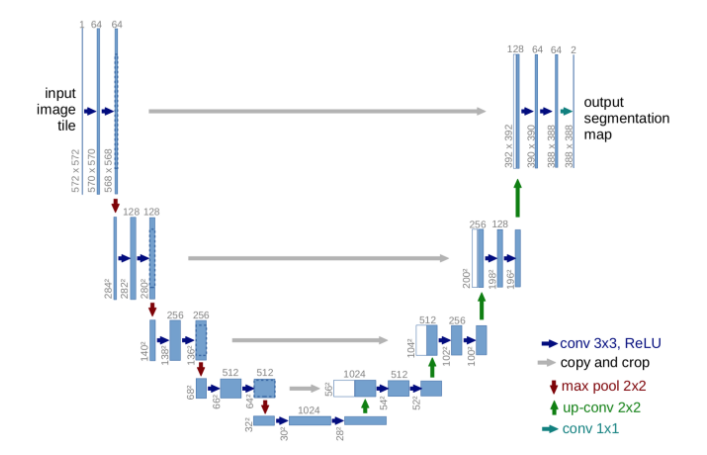

### What can we notice ?
- Unet Model has a “U” shape architecture with a symmetric Encoder and Decoder unlike FCN Decoder
- #### What do we mean by Symmetric Encoder and Decoder shape? 
  - Size of Encoder same as Size of Decoder 
- More Skip Connections between layers of Encoder and Decoder are used to make the information loss as minimal as possible
- Use of Convolutional layers in the Decoder part of the model too. For more accurate feature extraction while upsampling to the original size of the image

#### Conv2DTranspose vs UpSampling2D 

- For Upsampling, Unet uses Upsampling2D layers which is just a simple scaling up of the image by using nearest neighbour or bilinear upsampling instead of Conv2DTranspose layers
- UpSampling2D is a cheap operation than Conv2DTranspose due to less involvement of parameters to be learnt by the model and makes the model less memory intensive which helps it to be used in Mobile devices
 

With this now lets implement Unet from scratch and see how well it performs in smoothening the edges of the person segmentation mask.




In [ ]:
def UNet():
        
    inputs = tf.keras.Input(shape=(128,128,3))
    conv1 = tf.keras.layers.Conv2D(64,3,padding='same',activation='relu')(inputs)
    conv1 = tf.keras.layers.Conv2D(64,3,padding='same',activation='relu')(inputs)
    maxp1 = tf.keras.layers.MaxPooling2D(2)(conv1)
    
    conv2 = tf.keras.layers.Conv2D(128,3,padding='same',activation='relu')(maxp1)
    conv2 = tf.keras.layers.Conv2D(128,3,padding='same',activation='relu')(conv2)
    maxp2 = tf.keras.layers.MaxPooling2D(2)(conv2)

    conv3 = tf.keras.layers.Conv2D(256,3,padding='same',activation='relu')(maxp2)
    conv3 = tf.keras.layers.Conv2D(256,3,padding='same',activation='relu')(conv3)
    maxp3 = tf.keras.layers.MaxPooling2D(2)(conv3)

    conv4 = tf.keras.layers.Conv2D(512,3,padding='same',activation='relu')(maxp3)
    conv4 = tf.keras.layers.Conv2D(512,3,padding='same',activation='relu')(conv4)
    maxp4 = tf.keras.layers.MaxPooling2D(2)(conv4)
    
    conv5 = tf.keras.layers.Conv2D(1024,3,padding='same',activation='relu')(maxp4)
    conv5 = tf.keras.layers.Conv2D(1024,3,padding='same',activation='relu')(conv5)
    
    conv_up1 = tf.keras.layers.UpSampling2D()(conv5)
    conv_up1 = tf.keras.layers.Conv2D(512,3,padding='same',activation='relu')(conv_up1)    
    conv_up1 = tf.keras.layers.Concatenate()([conv_up1,conv4]) 
    conv_up1 = tf.keras.layers.Conv2D(512,3,padding='same',activation='relu')(conv_up1)

    conv_up2 = tf.keras.layers.UpSampling2D()(conv_up1)
    conv_up2 = tf.keras.layers.Conv2D(256,3,padding='same',activation='relu')(conv_up2)    
    conv_up2 = tf.keras.layers.Concatenate()([conv_up2,conv3]) 
    conv_up2 = tf.keras.layers.Conv2D(256,3,padding='same',activation='relu')(conv_up2)

    conv_up3 = tf.keras.layers.UpSampling2D()(conv_up2)
    conv_up3 = tf.keras.layers.Conv2D(128,3,padding='same',activation='relu')(conv_up3)    
    conv_up3 = tf.keras.layers.Concatenate()([conv_up3,conv2]) 
    conv_up3 = tf.keras.layers.Conv2D(128,3,padding='same',activation='relu')(conv_up3)


    conv_up4 = tf.keras.layers.UpSampling2D()(conv_up3)
    conv_up4 = tf.keras.layers.Conv2D(64,3,padding='same',activation='relu')(conv_up4)    
    conv_up4 = tf.keras.layers.Concatenate()([conv_up4,conv1]) 
    conv_up4 = tf.keras.layers.Conv2D(64,3,padding='same',activation='relu')(conv_up4)
    conv_up4 = tf.keras.layers.Conv2D(2,3,padding='same',activation='softmax')(conv_up4)

    return tf.keras.Model(inputs,conv_up4)

In [ ]:
unet = UNet()
unet.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_1 (Conv2D)              (None, 128, 128, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 max_pooling2d (MaxPooling2D)   (None, 64, 64, 64)   0           ['conv2d_1[0][0]']               
                                                                                              

In [ ]:
# TensorBoard callback to store performance metrics of the model while training

# log_dir = path+"logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
# tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)


In [ ]:
unet.compile(loss= 'categorical_crossentropy', optimizer="adam", metrics=["accuracy",dice_coefficient])

In [ ]:
# trains the UNet model
# hist = unet.fit(X_train,y_train,batch_size = 32,epochs = 20,validation_data=(X_test, y_test),callbacks=[tensorboard_callback] )

In [ ]:
%tensorboard --logdir /content/gdrive/MyDrive/Segmentation/logs/fit

Reusing TensorBoard on port 6007 (pid 409), started 0:23:23 ago. (Use '!kill 409' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
unet = tf.keras.models.load_model(path+'unet.h5', custom_objects={'dice_coefficient':dice_coefficient})

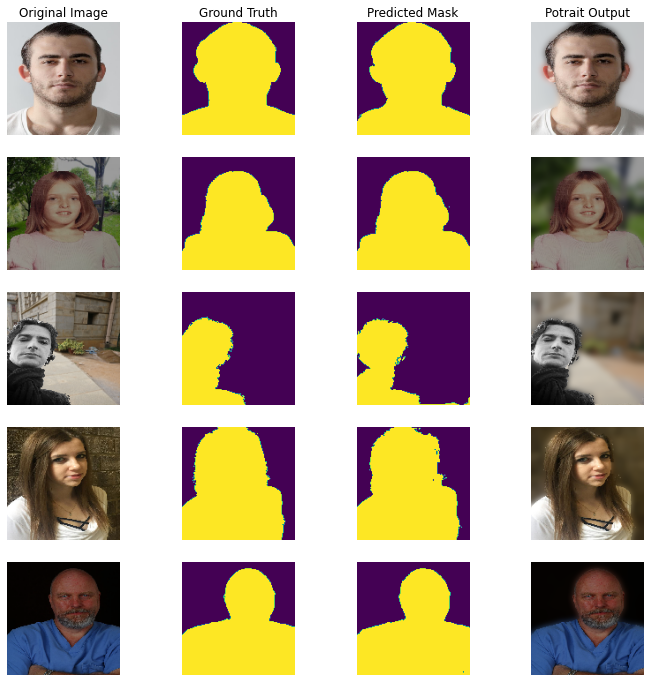

In [ ]:
preds = unet.predict(X_test[:5])
preds = np.argmax(preds,axis=-1)
y_true = np.argmax(y_test[:5],axis=-1)

fig,ax = plt.subplots(5,4,figsize=(12,12))

for idx1 in range(0,5):
    if idx1==0:
        ax[idx1][0].set_title('Original Image')
        ax[idx1][1].set_title('Ground Truth')
        ax[idx1][2].set_title('Predicted Mask')
        ax[idx1][3].set_title('Potrait Output')

    ax[idx1][0].imshow(X_test[idx1])
    ax[idx1][1].imshow(y_true[idx1])
    ax[idx1][2].imshow(preds[idx1])
    
    blurred_img = cv2.GaussianBlur(X_test[idx1].copy(), (21, 21), 0)
    out = np.where(preds[idx1][:,:,None]==np.array([1]), X_test[idx1].copy(), blurred_img)
    
    ax[idx1][3].imshow(out)
    
    ax[idx1][0].axis('off')
    ax[idx1][1].axis('off')
    ax[idx1][2].axis('off')
    ax[idx1][3].axis('off')
plt.show()


Though UNet performs relatively much better than FCN models, UNet is still not the SOTA for Image Segmentation tasks. 

- UNet requires many layers which makes training time quite significant.

- Relatively high GPU memory for larger images

Hence a faster model with relatively less parameters is required.

### Intuition for Mask RCNN
- Recall from the Object Detection Lecture, Faster RCNN was the SOTA model that quickly  produced highly accurate results



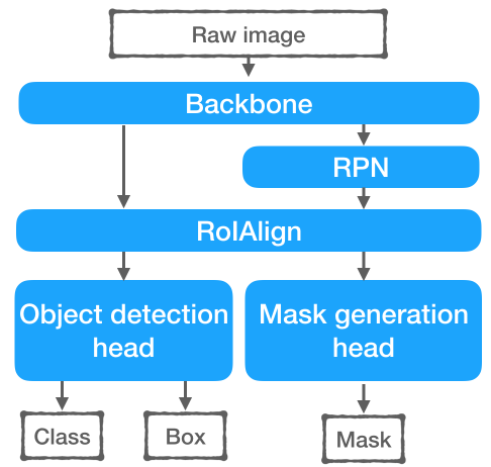

#### Mask R-CNN is just an extension of Faster R-CNN

#### What all can we notice ?
- The only new part is the mask generation head which is a fully Convolutional Head that upsamples to predict the mask

WHILE
- the remaining parts: backbone, a Region Proposal Network (RPN), a Region of Interest alignment layer (RoIAlign), a bounding-box object detection head are the same components as the Faster R-CNN in object detection.

#### Intution on how mask R-CNN works

 

 

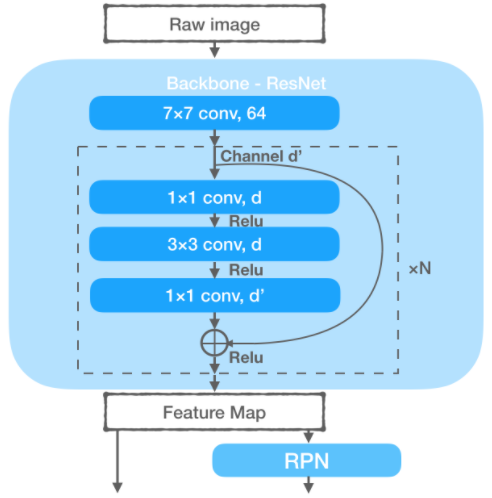

- First a backbone model like Resnet without the fully connected layers is used with multiple residual bottleneck blocks to make a deep residual network.
- In one bottleneck block, inputs go through two paths. One is multiple convolutional layers and the other is identical shortcut connection. 
- Then outputs from both paths are added element-wise. 
- This is how the feature maps are extracted that are fed to the the RPN component 

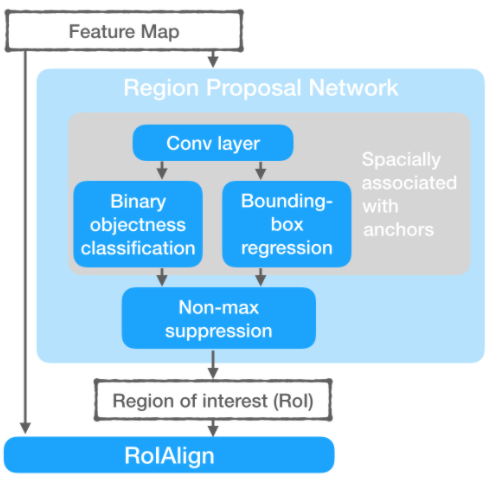

- A convolutional layer processes the feature map and outputs a c-channel tensor whose each spatial vector (also have c channels) is associated with an anchor center. 
- A set of anchor boxes with different scales and aspect ratios are generated given one anchor center. These anchor boxes are different areas that evenly distributed over the whole image and cover it completely. 
- Then two sibling 1 by 1 convolutional layers process the c-channel tensor. One is a binary classifier. It predicts whether each anchor box has an object. It maps each c-channel vector to a k-channel vector (represents k anchor boxes with different scales and aspect ratios sharing one anchor center). 
- The other is a object bounding-box regressor. It predicts the offsets between the true object bounding-box and the anchor box.
- For those overlapped bounding-boxes that may suggest the same object, we select ones with the highest objectness score, and drop the others. It's the Non-max suppression process.

- The next step is to find where exactly each RoI is in the feature map. This is where RoIAlign component helps

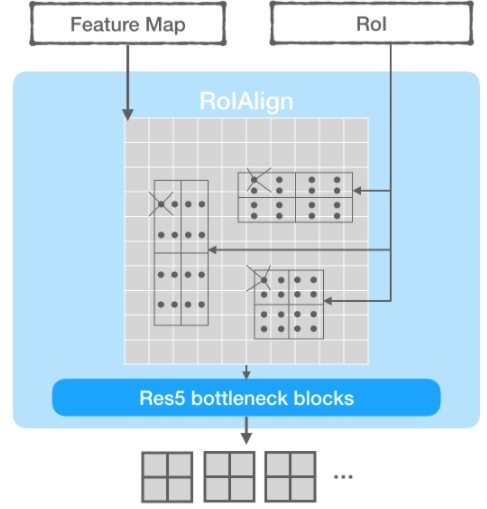

- We align RoI with their corresponding areas in the feature map by scaling. 
- These regions come in different locations, scales and aspect radios. 
- To get feature tensors of uniform shape, we sample over relevant aligned areas of the feature map. The white-bordered grid represents the feature map. The black-bordered grids represent RoIs. 
- We divide each RoI into a fixed number of bins. In each bin, there are 4 dots representing sample locations. 
- We sample feature vectors on the feature map grid around each dot and compute their bilinear interpolation as the dot vector. 
- Then we pool dot vectors within one bin to get a smaller fix-sized feature map for each RoI. 
- Next, we put each RoI's feature map into a set of residual bottleneck blocks to extract features further.
- Finally these are passed through an object detection head and a mask Generation head 

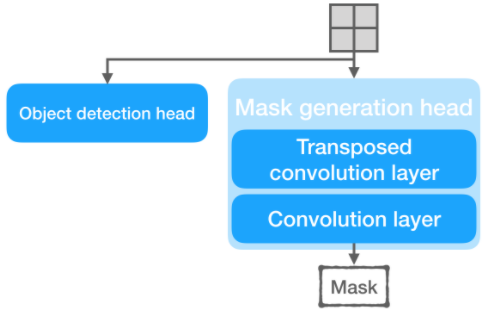

- The mask generation head just upsamples the feature maps to the size picked by the object detection branch.

### Intuition of DeepLabV3 (OPTIONAL)

- There is another SOTA model that usually performs better due to its recent restructuring in architecture and introducing much less computationally atrous/dilated Convolution layer
- https://arxiv.org/pdf/1706.05587v3.pdf



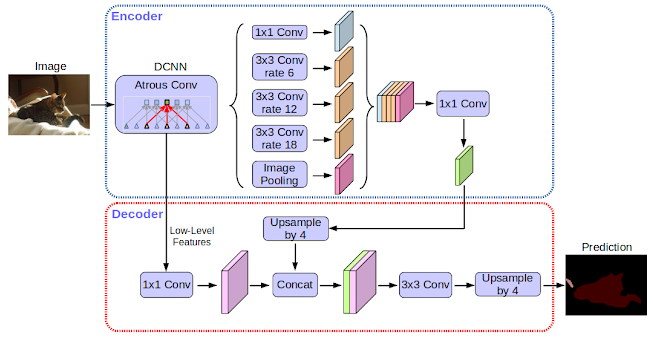

#### Atrous Convolution


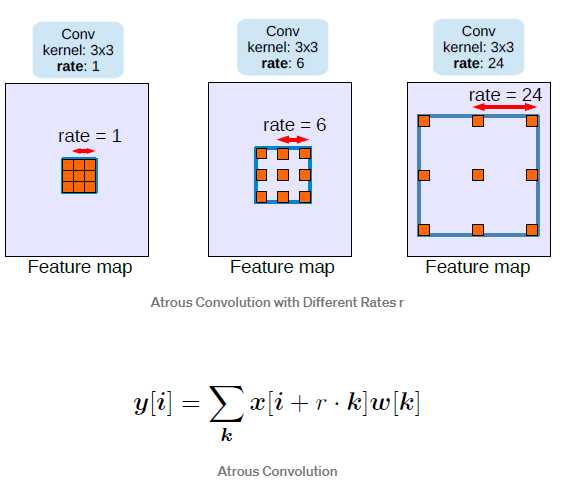

- For each location i on the output y and a filter w, atrous convolution is applied over the input feature map x where the atrous rate r corresponds to the stride with which we sample the input signal.

- This is equivalent to convolving the input x with upsampled filters produced by inserting r-1 zeros between two consecutive filter values along each spatial dimension. 

- When r=1, it is standard convolution.

- By adjusting r, we can adaptively modify filter’s field-of-view.

- It is also called dilated convolution 

#### How is Artous Convolution helpful ?
- Helps to have a border perspective of the image with the same number of parameters as the Standard Convolution layer 

#### How does different field of view helps? 
- captures larger context.
- Hence finds the best trade-off between accurate localization (small field-of-view) and context assimilation (large field-of-view).

#### Atrous Spatial Pyramid Pooling (ASPP)

BUT how do we know which field of view will work the best for our Business Problem  






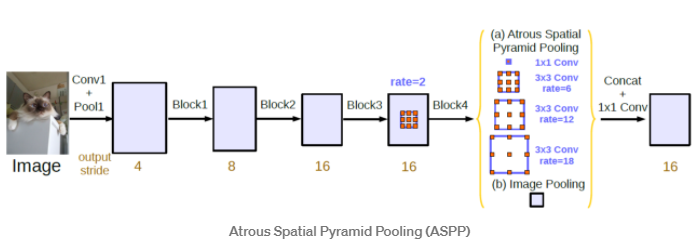

- With this reason, we use ASPP which uses one 1×1 convolution and three 3×3 convolutions with rates = (6, 12, 18) when output stride = 16. All with 256 filters and batch normalization  To have a much refined Feature maps.

- The rates are doubled when output stride = 8.

- Also, image pooling is included for global context which just uses a global Pooling layer followed by L2 Norm to further enhance the feature map by capturing the key features on the entirety of the image.

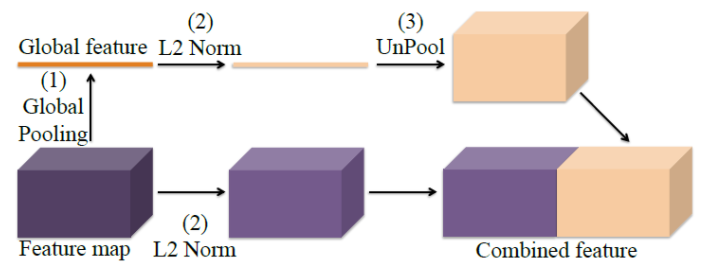


- The resulting features from all the branches are then concatenated and pass through another 1×1 convolution (also with 256 filters and batch normalization) before the final 1×1 convolution which generates the final logits.